In [13]:
import os 
import pandas as pd
import numpy as np
from tqdm.notebook import tqdm
from PIL import Image, ImageDraw

import torch
from torch import nn
import torchvision
from torch.nn import functional as F

import matplotlib.pyplot as plt

from utils.data import WoofDataset
from utils.train import classic_train

from torch.utils.data import DataLoader

In [9]:
torch.manual_seed(88)
np.random.seed(88)

device =  torch.device(('cuda:0' if torch.cuda.is_available() else 'cpu'))  # включаем поддержку GPU
device

device(type='cuda', index=0)

In [10]:
train_set = WoofDataset('data/imagewoof2/train', (256, 256))
val_set = WoofDataset('data/imagewoof2/val', (256, 256))

In [11]:
segnet = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True).cuda()
segnet.eval()
''

''

In [12]:
import numpy as np
from itertools import product

def corners(np_array):
    ind = np.argwhere(np_array)
    res = []
    for f1, f2 in product([min,max], repeat=2):
        res.append(f1(ind[ind[:, 0] == f2(ind[:, 0])], key=lambda x:x[1]))
    return res

  0%|          | 0/999 [00:00<?, ?it/s]

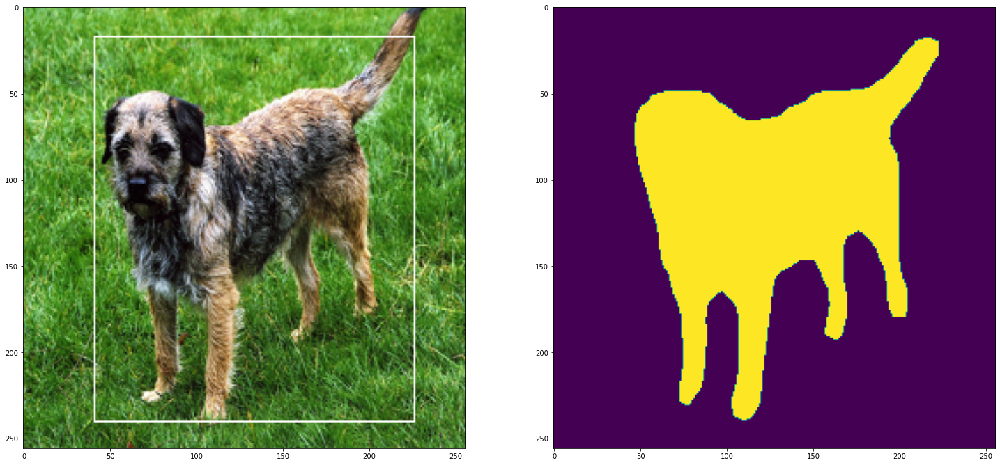

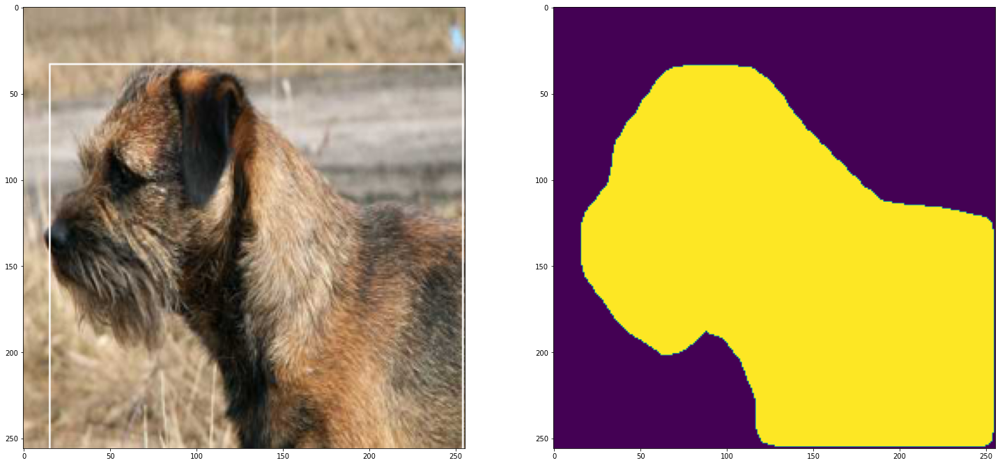

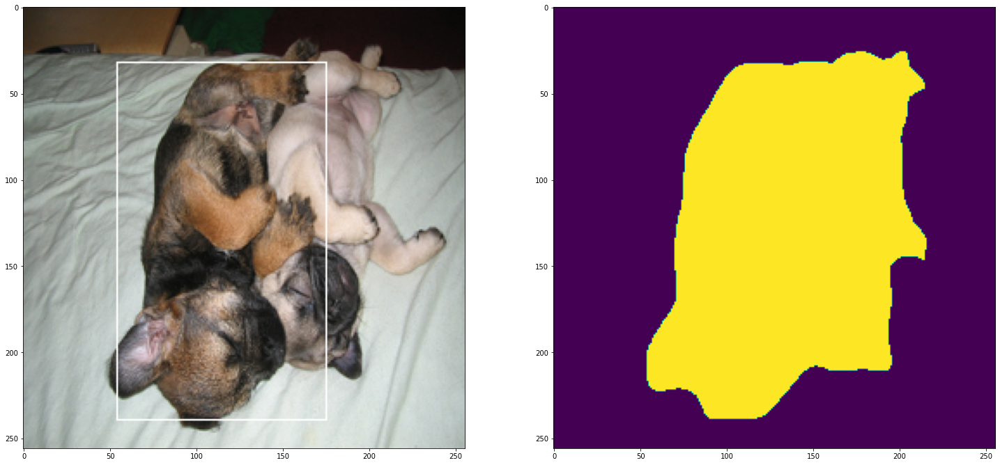

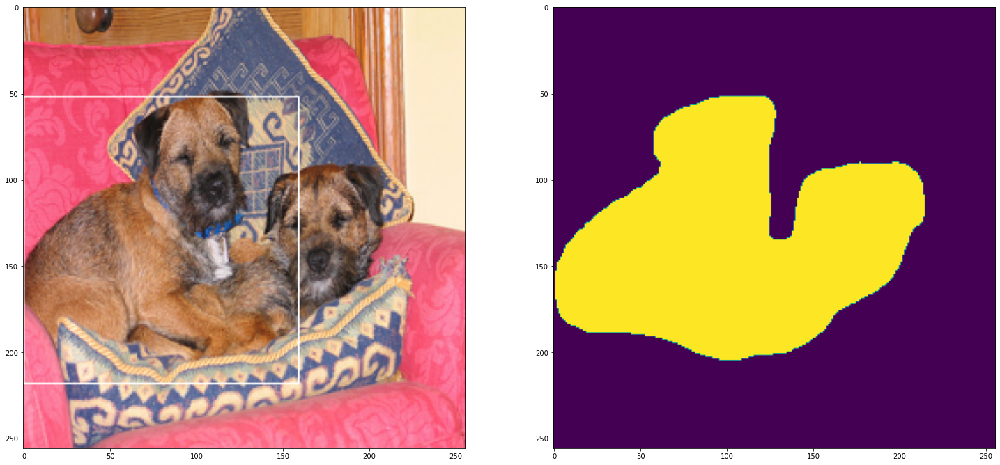

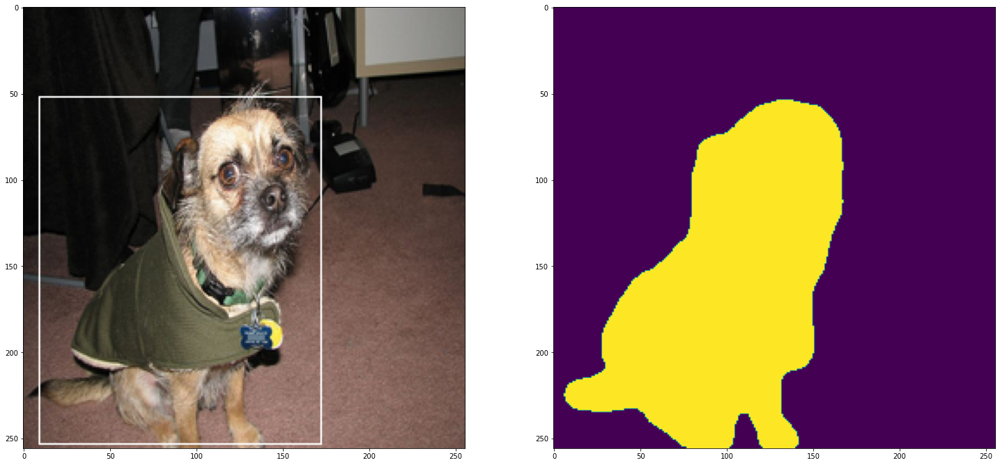

...

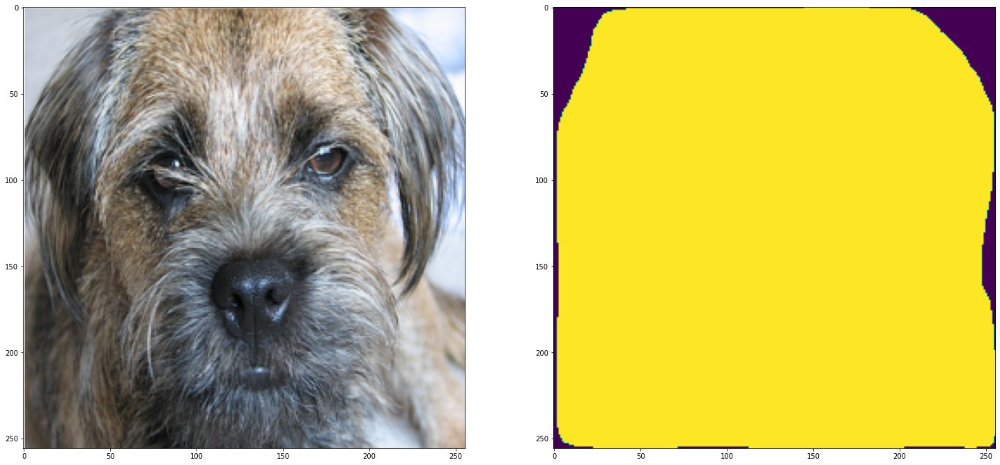

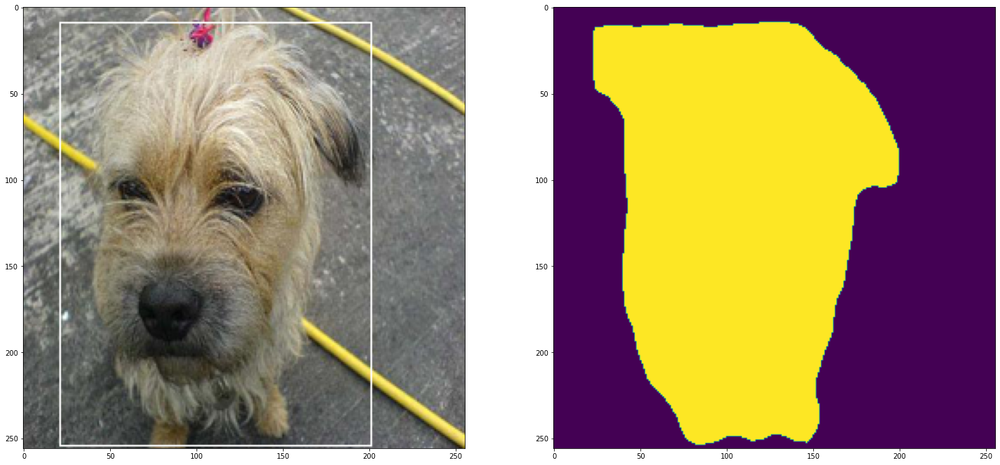

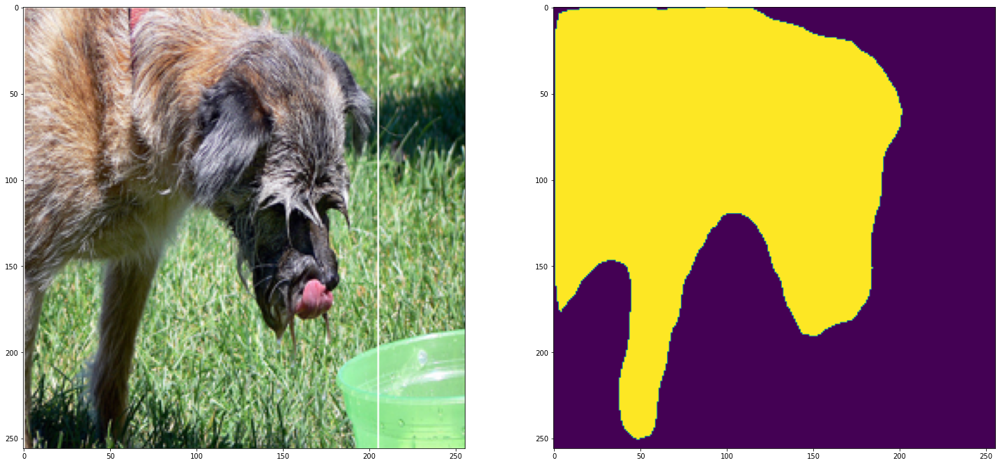

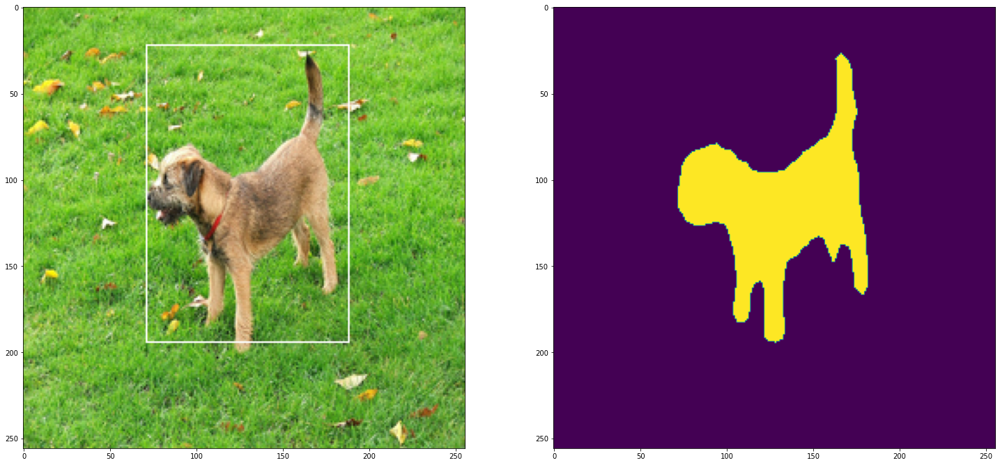

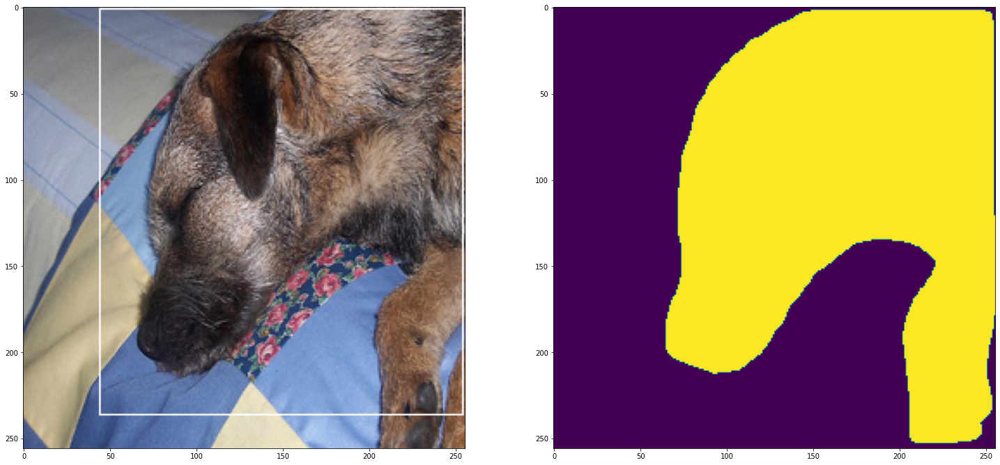

ValueError: zero-size array to reduction operation maximum which has no identity

In [7]:
def show_detection_n_masks(dataset, n):
    for idx in tqdm(range(1, n)):

        im = dataset.get_PIL(idx)
        x = [torch.Tensor(dataset[idx][0]).cuda()]
        predictions = segnet(x)[0]
        # print(predictions['boxes'].shape, )
        where = np.where(
            (predictions['labels'].cpu().detach().numpy() == 18) 
        )[0]

        boxes = predictions['boxes'].cpu().detach().numpy()[where]
        masks = predictions['masks'].cpu().detach().numpy()[where]
        mask = np.clip(masks, 0, 1).sum(0)[0]


        draw = ImageDraw.Draw(im)
        ''' 
        box = corners(mask)
        print(np.array([box[0], box[3]]))
        draw.rectangle(np.array([box[0], box[3]]).astype(float).flatten())
        '''
        #for box in boxes:
        draw.rectangle(boxes[predictions['scores'].cpu().detach().numpy()[where] 
                             == predictions['scores'].cpu().detach().numpy()[where].max()])

        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(25, 25))
        # axes[0].imshow(im * (np.stack([mask for _ in range(3)], 2) > 0.3))
        axes[0].imshow(im)
        axes[1].imshow(mask > 0.5)

        plt.show()

In [22]:
from os.path import join

def crop_n_mask(dataset, path='data/woof_cut/train'):
    
    for idx in tqdm(range(len(dataset))):
        
        img = dataset.get_PIL(idx)
        x = [torch.Tensor(dataset[idx][0]).cuda()]
        predictions = segnet(x)[0]
        
        pred_labels = predictions['labels'].cpu().detach().numpy()
        pred_boxes = predictions['boxes'].cpu().detach().numpy()
        pred_masks = predictions['masks'].cpu().detach().numpy()
        pred_scores = predictions['scores'].cpu().detach().numpy()

        where = np.where(
            (pred_labels == 18) 
        )[0]
        
        if where.size == 0:
            continue

        boxes = pred_boxes[where]
        masks = pred_masks[where]
        mask = np.clip(masks, 0, 1).sum(0)[0]
        
        boxed = img.crop(boxes[pred_scores[where] == pred_scores[where].max()][0])
        mask = Image.fromarray(mask).crop(boxes[pred_scores[where] == pred_scores[where].max()][0])
        masked = boxed * (np.stack([mask for _ in range(3)], 2) > 0.3)
        masked = Image.fromarray(masked)
        
        img_name = dataset.X[idx].split(os.path.sep)[-1]
        label = dataset.X[idx].split(os.path.sep)[-2]
        
        boxed_path = join(path, 'boxed', label, )
        masked_path = join(path, 'masked', label, )
        
        if not os.path.isdir(boxed_path):
            os.makedirs(boxed_path)
            
        if not os.path.isdir(masked_path):
            os.makedirs(masked_path)
            
        boxed.save(join(boxed_path, img_name))
        masked.save(join(masked_path, img_name))
        

In [17]:
crop_n_mask(train_set, path='data/woof_cut/train')

  0%|          | 0/9025 [00:00<?, ?it/s]

In [23]:
crop_n_mask(val_set, path='data/woof_cut/val')

  0%|          | 0/3929 [00:00<?, ?it/s]